In [1]:
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
from pykalman import KalmanFilter
from statsmodels.nonparametric.smoothers_lowess import lowess
from scipy import signal
import scipy.fftpack
from mpl_toolkits.mplot3d import Axes3D

# Reading the files and assigning Ordinal values as labels


We had three different kinds of data namely for Walking,Standing and Running.Firstly, we read the data from the csv files into dataframes and appended them together respectively.

We encoded valus as follows:


Standing:0

Walking:1

Running:2

# A.1 Files for Walking:

In [2]:
walk1=pd.read_csv("data/rawdata/walking/walk1.csv")
walk1['Activity']='1'
walk2=pd.read_csv("data/rawdata/walking/walk2.csv")
walk2['Activity']='1'
walk3=pd.read_csv("data/rawdata/walking/walk3.csv")
walk3['Activity']='1'
walk4=pd.read_csv("data/rawdata/walking/walk4.csv")
walk4['Activity']='1'
walk5=pd.read_csv("data/rawdata/walking/walk5.csv")
walk5['Activity']='1'
walk6=pd.read_csv("data/rawdata/walking/walk6.csv")
walk6['Activity']='1'
walk7=pd.read_csv("data/rawdata/walking/walk7.csv")
walk7['Activity']='1'
walk8=pd.read_csv("data/rawdata/walking/walk8.csv")
walk8['Activity']='1'
walk9=pd.read_csv("data/rawdata/walking/walk9.csv")
walk9['Activity']='1'
walk10=pd.read_csv("data/rawdata/walking/walk10.csv")
walk10['Activity']='1'

walk11=pd.read_csv("data/rawdata/walking/walk11.csv")
walk11['Activity']='1'
walk12=pd.read_csv("data/rawdata/walking/walk12.csv")
walk12['Activity']='1'
walk13=pd.read_csv("data/rawdata/walking/walk13.csv")
walk13['Activity']='1'
walk14=pd.read_csv("data/rawdata/walking/walk14.csv")
walk14['Activity']='1'
walk15=pd.read_csv("data/rawdata/walking/walk15.csv")
walk15['Activity']='1'
walk16=pd.read_csv("data/rawdata/walking/walk16.csv")
walk16['Activity']='1'
walk17=pd.read_csv("data/rawdata/walking/walk17.csv")
walk17['Activity']='1'
walk18=pd.read_csv("data/rawdata/walking/walk18.csv")
walk18['Activity']='1'
walk19=pd.read_csv("data/rawdata/walking/walk19.csv")
walk19['Activity']='1'
walk20=pd.read_csv("data/rawdata/walking/walk20.csv")
walk20['Activity']='1'

walk21=pd.read_csv("data/rawdata/walking/walk21.csv")
walk21['Activity']='1'
walk22=pd.read_csv("data/rawdata/walking/walk22.csv")
walk22['Activity']='1'
walk23=pd.read_csv("data/rawdata/walking/walk23.csv")
walk23['Activity']='1'
walk24=pd.read_csv("data/rawdata/walking/walk24.csv")
walk24['Activity']='1'
walk25=pd.read_csv("data/rawdata/walking/walk25.csv")
walk25['Activity']='1'
walk26=pd.read_csv("data/rawdata/walking/walk26.csv")
walk26['Activity']='1'
walk27=pd.read_csv("data/rawdata/walking/walk27.csv")
walk27['Activity']='1'
walk28=pd.read_csv("data/rawdata/walking/walk28.csv")
walk28['Activity']='1'
walk29=pd.read_csv("data/rawdata/walking/walk29.csv")
walk29['Activity']='1'
walk30=pd.read_csv("data/rawdata/walking/walk30.csv")
walk30['Activity']='1'




In [3]:
walkdf=[walk1,walk2,walk3,walk4,walk5,walk6,walk7,walk8,walk9,walk10,walk11,walk12,walk13,walk14,walk15,walk16,walk17,walk18,walk19,walk20,walk21,walk22,walk23,walk24,walk25,walk26,walk27,walk28,walk29,walk30]

In [4]:
#walkdf


# A.2 Checking for null values in Walk dataframes

In [5]:
walkdfapp = walk1.append([walk1,walk2,walk3,walk4,walk5,walk6,walk7,walk8,walk9,walk10,walk11,walk12,walk13,walk14,walk15,walk16,walk17,walk18,walk19,walk20,walk21,walk22,walk23,walk24,walk25,walk26,walk27,walk28,walk29,walk30])

In [6]:
walkdfapp

,time,gFx,gFy,gFz,acc,Activity
0,50:58.7,-0.030,-0.200,-0.809,0.834,1
1,50:58.7,-0.003,-0.233,-0.854,0.885,1
2,50:58.7,-0.038,-0.330,-0.879,0.940,1
3,50:58.8,-0.074,-0.390,-0.885,0.970,1
4,50:58.8,-0.123,-0.459,-1.032,1.136,1
...,...,...,...,...,...,...
2593,33:15.9,0.042,-0.178,-0.885,0.904,1
2594,33:15.9,0.028,-0.181,-0.882,0.901,1
2595,33:15.9,-0.006,-0.176,-0.870,0.888,1
2596,33:15.9,-0.018,-0.183,-0.808,0.829,1


In [7]:
walkdfapp.shape[0]

84830

In [8]:
walkdfapp.isnull().sum()

time        0
gFx         0
gFy         0
gFz         0
acc         0
Activity    0
dtype: int64

# A.3 Applying Lowess Filter for Walking Data

We applied Lowess filter on gFx column of dataframe for mere observations on how noisy the data is and how does smoothening affect it

In [9]:
input_range=np.linspace(0,60000,84830)
input_range

array([0.00000000e+00, 7.07305285e-01, 1.41461057e+00, ...,
       5.99985854e+04, 5.99992927e+04, 6.00000000e+04])

In [10]:
r=walkdfapp['gFx']

In [11]:
#It will take a couple of minutes to run
filtered=lowess(r,input_range,frac=0.2)

<Figure size 1080x1080 with 0 Axes>

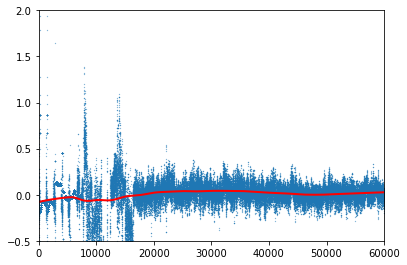

In [12]:
plt.figure(figsize=(15,15))
a= plt.figure()
axes= a.add_axes([0.1,0.1,0.8,0.8])
axes.set_xlim([0,60000])
axes.set_ylim([-.5,2])
plt.scatter(input_range,r, s=0.05)
plt.plot(filtered[:,0],filtered[:,1],'r-',linewidth=2)
plt.show()

# B.1 Files for standing:

In [13]:
standing1=pd.read_csv("data/rawdata/standing/standing1.csv")
standing1['Activity']='0'
standing2=pd.read_csv("data/rawdata/standing/standing2.csv")
standing2['Activity']='0'
standing3=pd.read_csv("data/rawdata/standing/standing3.csv")
standing3['Activity']='0'
standing4=pd.read_csv("data/rawdata/standing/standing4.csv")
standing4['Activity']='0'
standing5=pd.read_csv("data/rawdata/standing/standing5.csv")
standing5['Activity']='0'
standing6=pd.read_csv("data/rawdata/standing/standing6.csv")
standing6['Activity']='0'
standing7=pd.read_csv("data/rawdata/standing/standing7.csv")
standing7['Activity']='0'
standing8=pd.read_csv("data/rawdata/standing/standing8.csv")
standing8['Activity']='0'
standing9=pd.read_csv("data/rawdata/standing/standing9.csv")
standing9['Activity']='0'
standing10=pd.read_csv("data/rawdata/standing/standing10.csv")
standing10['Activity']='0'


standing11=pd.read_csv("data/rawdata/standing/standing11.csv")
standing11['Activity']='0'
standing12=pd.read_csv("data/rawdata/standing/standing12.csv")
standing12['Activity']='0'
standing13=pd.read_csv("data/rawdata/standing/standing13.csv")
standing13['Activity']='0'
standing14=pd.read_csv("data/rawdata/standing/standing14.csv")
standing14['Activity']='0'
standing15=pd.read_csv("data/rawdata/standing/standing15.csv")
standing15['Activity']='0'
standing16=pd.read_csv("data/rawdata/standing/standing16.csv")
standing16['Activity']='0'
standing17=pd.read_csv("data/rawdata/standing/standing17.csv")
standing17['Activity']='0'
standing18=pd.read_csv("data/rawdata/standing/standing18.csv")
standing18['Activity']='0'
standing19=pd.read_csv("data/rawdata/standing/standing19.csv")
standing19['Activity']='0'
standing20=pd.read_csv("data/rawdata/standing/standing20.csv")
standing20['Activity']='0'



standing21=pd.read_csv("data/rawdata/standing/standing21.csv")
standing21['Activity']='0'
standing22=pd.read_csv("data/rawdata/standing/standing22.csv")
standing22['Activity']='0'
standing23=pd.read_csv("data/rawdata/standing/standing23.csv")
standing23['Activity']='0'
standing24=pd.read_csv("data/rawdata/standing/standing24.csv")
standing24['Activity']='0'
standing25=pd.read_csv("data/rawdata/standing/standing25.csv")
standing25['Activity']='0'
standing26=pd.read_csv("data/rawdata/standing/standing26.csv")
standing26['Activity']='0'
standing27=pd.read_csv("data/rawdata/standing/standing27.csv")
standing27['Activity']='0'
standing28=pd.read_csv("data/rawdata/standing/standing28.csv")
standing28['Activity']='0'
standing29=pd.read_csv("data/rawdata/standing/standing29.csv")
standing29['Activity']='0'
standing30=pd.read_csv("data/rawdata/standing/standing30.csv")
standing30['Activity']='0'



In [14]:
standingdf=[standing1,standing2,standing3,standing4,standing5,standing6,standing7,standing8,standing9,standing10,standing11,standing12,standing13,standing14,standing15,standing16,standing17,standing18,standing19,standing20,standing21,standing22,standing22,standing23,standing24,standing25,standing26,standing27,standing28,standing29,standing30]


# B.2 Checking for Null values in Standing dataframes

In [15]:
standingdfapp=standing1.append([standing1,standing2,standing3,standing4,standing5,standing6,standing7,standing8,standing9,standing10,standing11,standing12,standing13,standing14,standing15,standing16,standing17,standing18,standing19,standing20,standing21,standing22,standing22,standing23,standing24,standing25,standing26,standing27,standing28,standing29,standing30])

In [16]:
standingdfapp.shape[0]

74679

In [17]:
standingdfapp.isnull().sum()

time        0
gFx         0
gFy         0
gFz         0
acc         0
Activity    0
dtype: int64

# B.3 Applying Lowess Filter for Standing Data

We applied Lowess filter on gFx column for mere observations on how noisy the data is and how does smoothening affect it

In [18]:
input_range=np.linspace(0,60000,74679)
input_range

array([0.00000000e+00, 8.03449476e-01, 1.60689895e+00, ...,
       5.99983931e+04, 5.99991966e+04, 6.00000000e+04])

In [19]:
r=standingdfapp['gFx']

In [20]:
#It will take a couple of minutes to run
filtered=lowess(r,input_range,frac=0.2)



<Figure size 1080x1080 with 0 Axes>

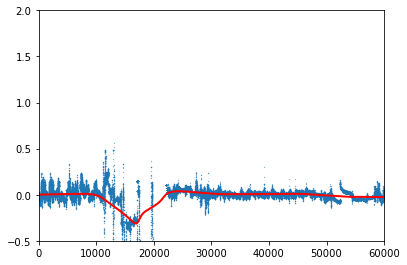

In [21]:
plt.figure(figsize=(15,15))
a= plt.figure()
axes= a.add_axes([0.1,0.1,0.8,0.8])
axes.set_xlim([0,60000])
axes.set_ylim([-.5,2])
plt.scatter(input_range,r, s=0.05)
plt.plot(filtered[:,0],filtered[:,1],'r-',linewidth=2)
plt.show()


# C.1 Files for running:

In [22]:
running1=pd.read_csv("data/rawdata/running/running1.csv")
running1['Activity']='2'
running2=pd.read_csv("data/rawdata/running/running2.csv")
running2['Activity']='2'
running3=pd.read_csv("data/rawdata/running/running3.csv")
running3['Activity']='2'
running4=pd.read_csv("data/rawdata/running/running4.csv")
running4['Activity']='2'
running5=pd.read_csv("data/rawdata/running/running5.csv")
running5['Activity']='2'
running6=pd.read_csv("data/rawdata/running/running6.csv")
running6['Activity']='2'
running7=pd.read_csv("data/rawdata/running/running7.csv")
running7['Activity']='2'
running8=pd.read_csv("data/rawdata/running/running8.csv")
running8['Activity']='2'
running9=pd.read_csv("data/rawdata/running/running9.csv")
running9['Activity']='2'
running10=pd.read_csv("data/rawdata/running/running10.csv")
running10['Activity']='2'


running11=pd.read_csv("data/rawdata/running/running11.csv")
running11['Activity']='2'
running12=pd.read_csv("data/rawdata/running/running12.csv")
running12['Activity']='2'
running13=pd.read_csv("data/rawdata/running/running13.csv")
running13['Activity']='2'
running14=pd.read_csv("data/rawdata/running/running14.csv")
running14['Activity']='2'
running15=pd.read_csv("data/rawdata/running/running15.csv")
running15['Activity']='2'
running16=pd.read_csv("data/rawdata/running/running16.csv")
running16['Activity']='2'
running17=pd.read_csv("data/rawdata/running/running17.csv")
running17['Activity']='2'
running18=pd.read_csv("data/rawdata/running/running18.csv")
running18['Activity']='2'
running19=pd.read_csv("data/rawdata/running/running19.csv")
running19['Activity']='2'
running20=pd.read_csv("data/rawdata/running/running20.csv")
running20['Activity']='2'


running21=pd.read_csv("data/rawdata/running/running21.csv")
running21['Activity']='2'
running22=pd.read_csv("data/rawdata/running/running22.csv")
running22['Activity']='2'
running23=pd.read_csv("data/rawdata/running/running23.csv")
running23['Activity']='2'
running24=pd.read_csv("data/rawdata/running/running24.csv")
running24['Activity']='2'
running25=pd.read_csv("data/rawdata/running/running25.csv")
running25['Activity']='2'
running26=pd.read_csv("data/rawdata/running/running26.csv")
running26['Activity']='2'
running27=pd.read_csv("data/rawdata/running/running27.csv")
running27['Activity']='2'
running28=pd.read_csv("data/rawdata/running/running28.csv")
running28['Activity']='2'
running29=pd.read_csv("data/rawdata/running/running29.csv")
running29['Activity']='2'
running30=pd.read_csv("data/rawdata/running/running30.csv")
running30['Activity']='2'


In [23]:
runningdf=[running1,running2,running3,running4,running5,running6,running7,running8,running9,running10,running11,running12,running13,running14,running15,running16,running17,running18,running19,running20,running21,running22,running23,running24,running25,running26,running27,running28,running29,running30]
#runningdf

# C.2 Checking for Null values in Running Dataframes

In [24]:
runningdfapp=running1.append([running1,running2,running3,running4,running5,running6,running7,running8,running9,running10,running11,running12,running13,running14,running15,running16,running17,running18,running19,running20,running21,running22,running23,running24,running25,running26,running27,running28,running29,running30])

In [25]:
runningdfapp

,time,gFx,gFy,gFz,acc,Activity
0,05:47.3,0.004,-0.371,-0.446,0.580,2
1,05:47.3,0.004,-0.371,-0.446,0.580,2
2,05:47.3,0.072,-0.441,-0.490,0.663,2
3,05:47.3,0.102,-0.469,-0.476,0.676,2
4,05:47.4,0.085,-0.464,-0.471,0.667,2
...,...,...,...,...,...,...
1646,30:01.0,0.125,-0.445,-0.768,0.896,2
1647,30:01.0,0.131,-0.381,-0.925,1.009,2
1648,30:01.0,0.128,-0.355,-1.003,1.072,2
1649,30:01.0,0.141,-0.342,-1.093,1.154,2


In [26]:
runningdfapp.shape[0]

52391

In [27]:
runningdfapp.isnull().sum()

time        0
gFx         0
gFy         0
gFz         0
acc         0
Activity    0
dtype: int64

# C.3 Applying The Lowess Filter on Running Dataframes


We applied Lowess filter on gFx column for mere observations on how noisy the data is and how does smoothening affect it

In [28]:
input_range=np.linspace(0,60000,52391)
input_range

array([0.00000000e+00, 1.14525673e+00, 2.29051346e+00, ...,
       5.99977095e+04, 5.99988547e+04, 6.00000000e+04])

In [29]:
r=runningdfapp['gFx']

In [30]:
#It will take a couple of minutes to run
filtered=lowess(r,input_range,frac=0.2)


<Figure size 1080x1080 with 0 Axes>

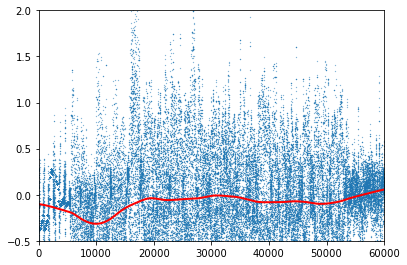

In [31]:
plt.figure(figsize=(15,15))
a= plt.figure()
axes= a.add_axes([0.1,0.1,0.8,0.8])
axes.set_xlim([0,60000])
axes.set_ylim([-.5,2])
plt.scatter(input_range,r, s=0.05)
plt.plot(filtered[:,0],filtered[:,1],'r-',linewidth=2)
plt.show()

# Using a low pass filter : ButterWorth Filter

Based on the above observations,we can see that Lowess filter only works to smoothen the curve. It does not give us true values.

In [32]:
#using low pass filter 
b, a = signal.butter(3, 0.1, btype='lowpass', analog=False)

walk_np=list(walkdf)
standing_np=list(standingdf)
running_np=list(runningdf)


# 1(a) . ButterWorth Filter on Walking Data

While applying Butterworth filter and transformations, we are not considering the class labels.We will add those labels in our next ipynb file i.e Statistics.ipynb

In [33]:
butter_worth_walk = []
for i in range(30):
    butter_worth_walkX = signal.filtfilt(b, a, walk_np[i]["gFx"])
    butter_worth_walkY = signal.filtfilt(b, a, walk_np[i]["gFy"])
    butter_worth_walkZ = signal.filtfilt(b, a, walk_np[i]["gFz"])

    butter_worth_walk.append((pd.DataFrame(list(zip(walk_np[i]['time'],butter_worth_walkX, butter_worth_walkY, butter_worth_walkZ,walk_np[i]['acc'])),
                                            columns=["Time","AccX", "AccY", "AccZ","Acc-old"])))
    
    
    
    
   
    
    

In [34]:
for i in range(30):
    butter_worth_walk[i]["Acc-trns"] = np.sqrt(butter_worth_walk[i]["AccX"]**2 * 
                                                     butter_worth_walk[i]["AccY"]**2 *
                                                     butter_worth_walk[i]["AccZ"]**2 ) 
    
butter_worth_walk[0]

,Time,AccX,AccY,AccZ,Acc-old,Acc-trns
0,50:58.7,-0.034059,-0.193109,-0.792666,0.834,0.005214
1,50:58.7,-0.054152,-0.217680,-0.793732,0.885,0.009356
2,50:58.7,-0.072244,-0.240606,-0.794303,0.940,0.013807
3,50:58.8,-0.086890,-0.260312,-0.793582,0.970,0.017950
4,50:58.8,-0.096815,-0.275805,-0.791350,1.136,0.021131
...,...,...,...,...,...,...
1832,51:25.5,-0.139699,-0.451786,-1.018895,1.117,0.064306
1833,51:25.5,-0.146444,-0.419644,-1.031833,1.117,0.063411
1834,51:25.5,-0.152605,-0.387077,-1.045610,1.133,0.061764
1835,51:25.5,-0.158078,-0.354912,-1.059830,1.133,0.059461


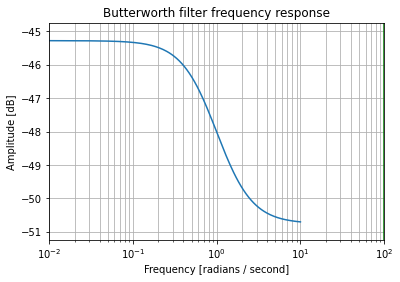

In [35]:
#######Walking data########
w, h = signal.freqs(b, a)
plt.semilogx(w, 20 * np.log10(abs(h)))
plt.title('Butterworth filter frequency response')
plt.xlabel('Frequency [radians / second]')
plt.ylabel('Amplitude [dB]')
plt.margins(0, 0.1)
plt.grid(which='both', axis='both')
plt.axvline(100, color='green') # cutoff frequency
plt.show()


# 1(b) Transformations on Walking data

/Users/Srimalaya/.conda/envs/CMPT353/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


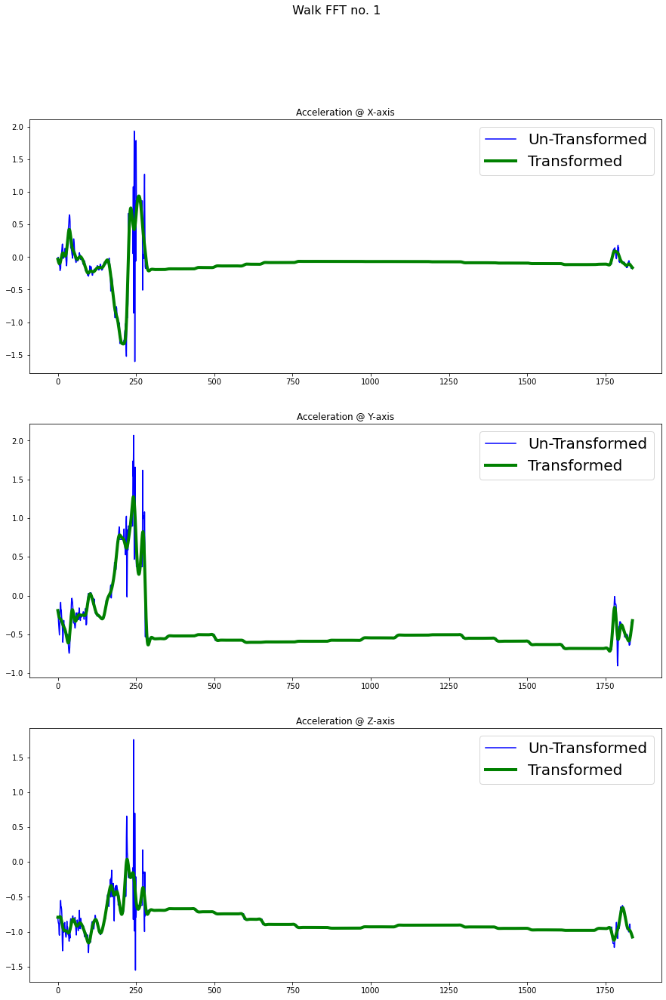

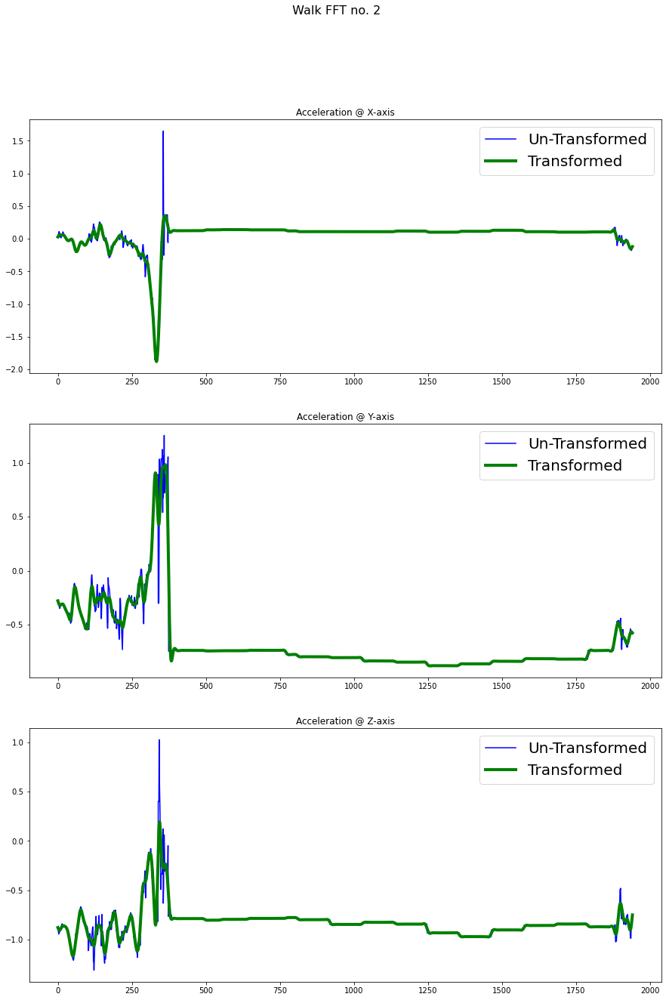

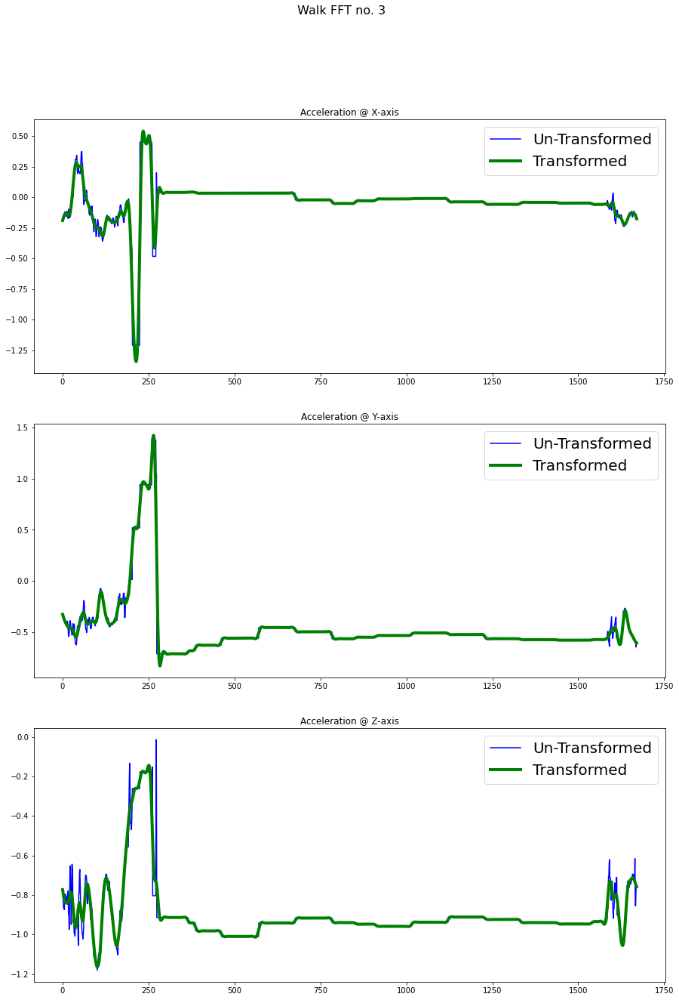

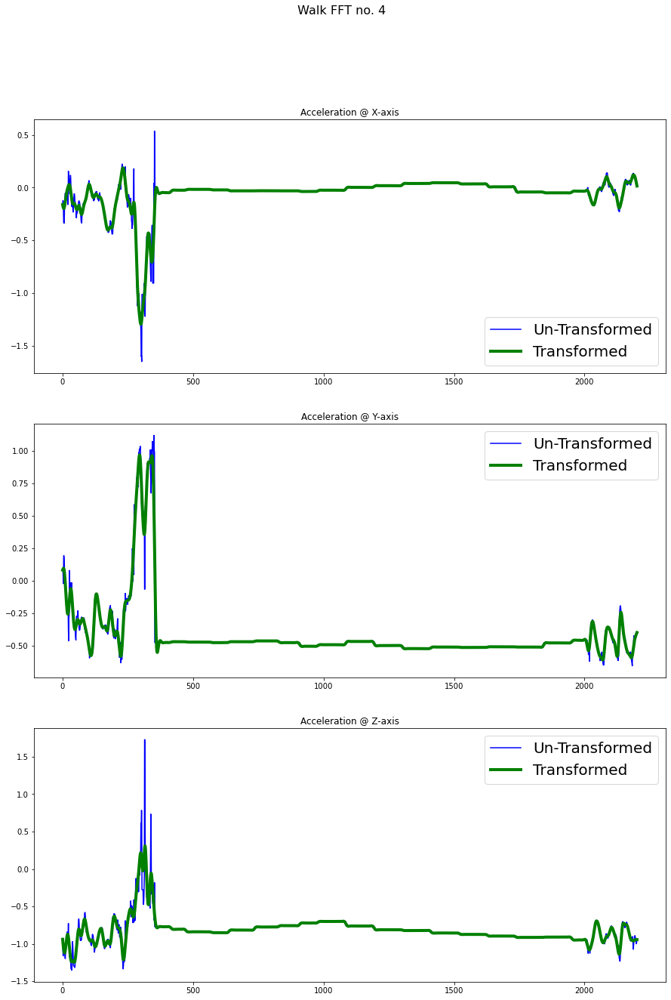

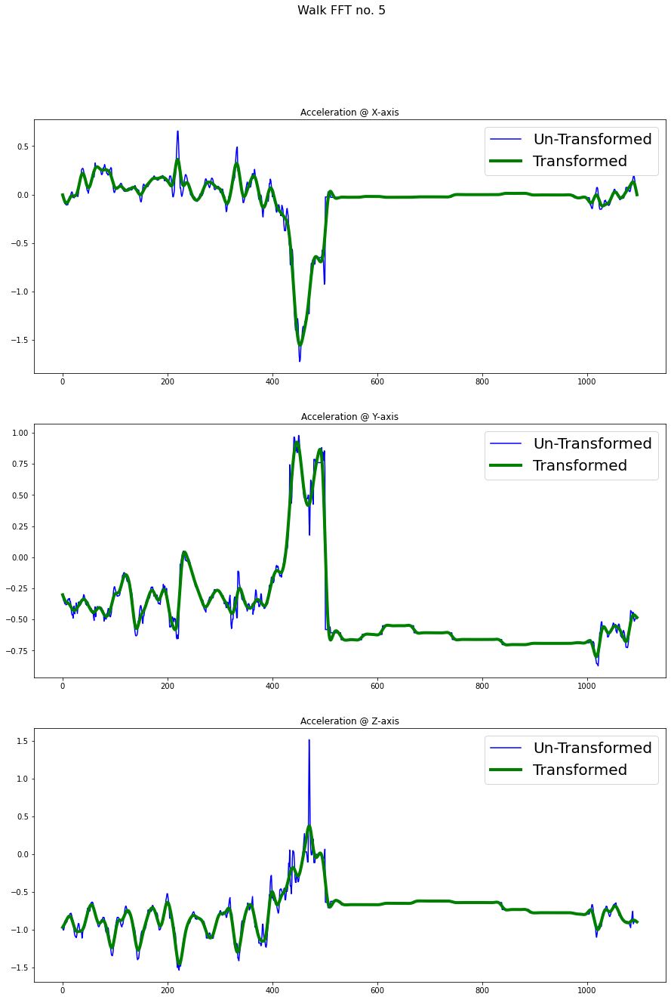

...

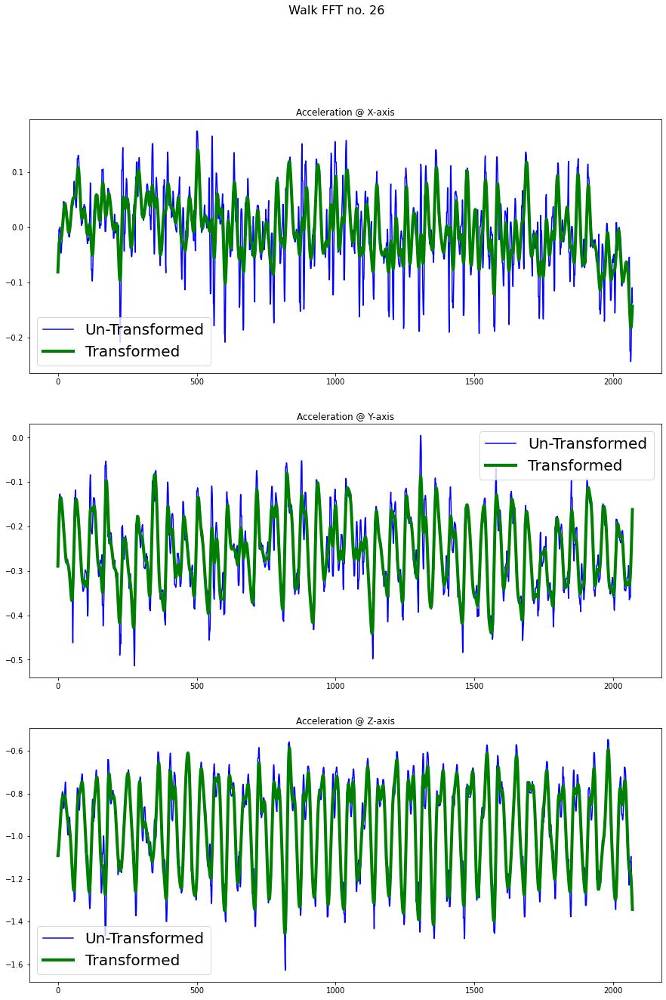

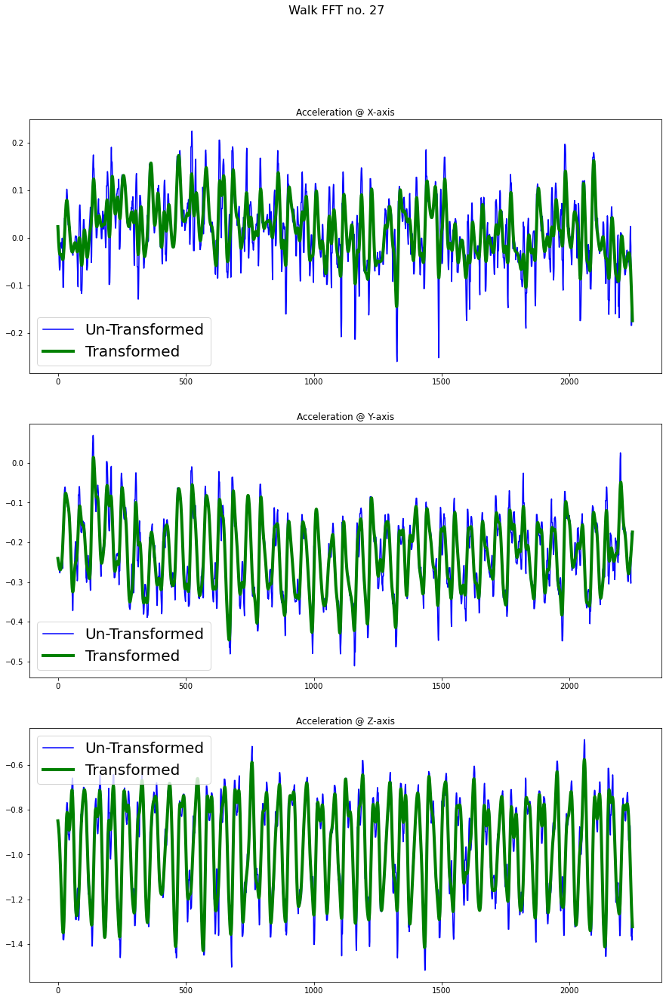

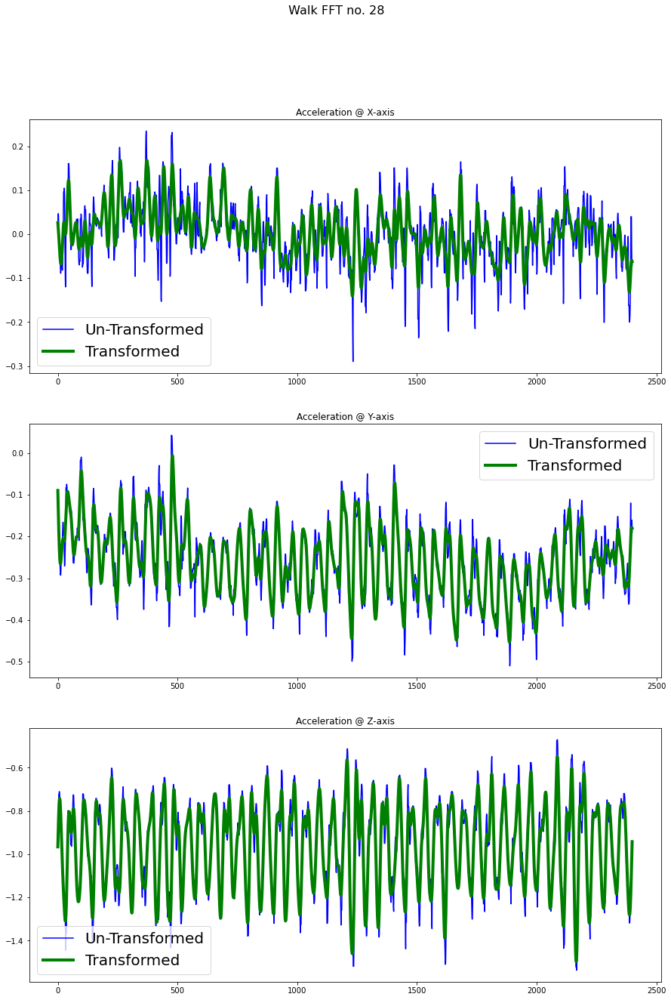

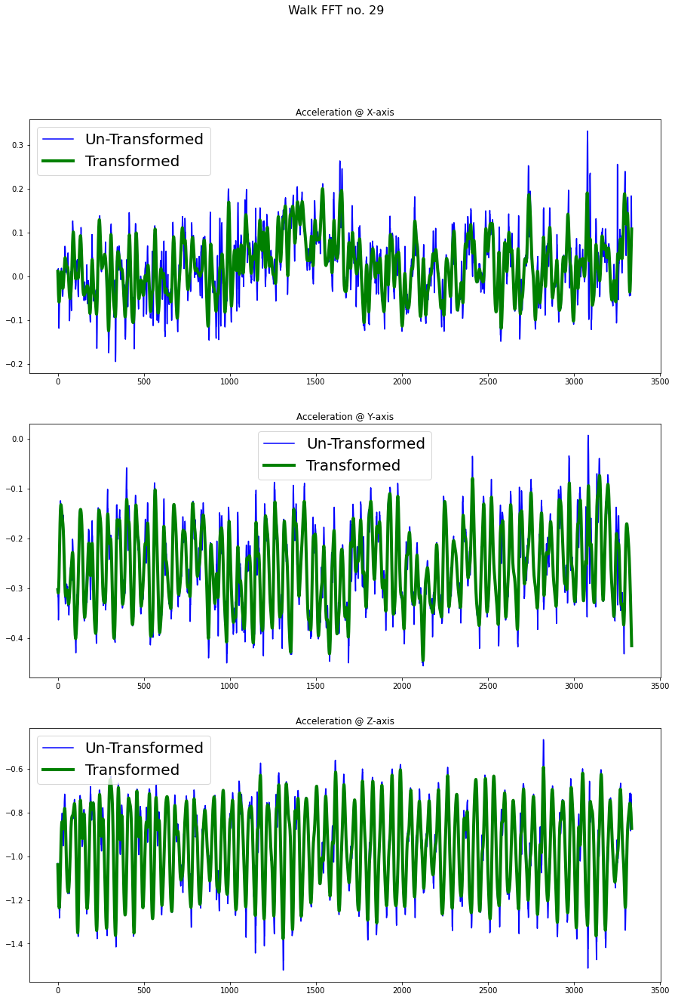

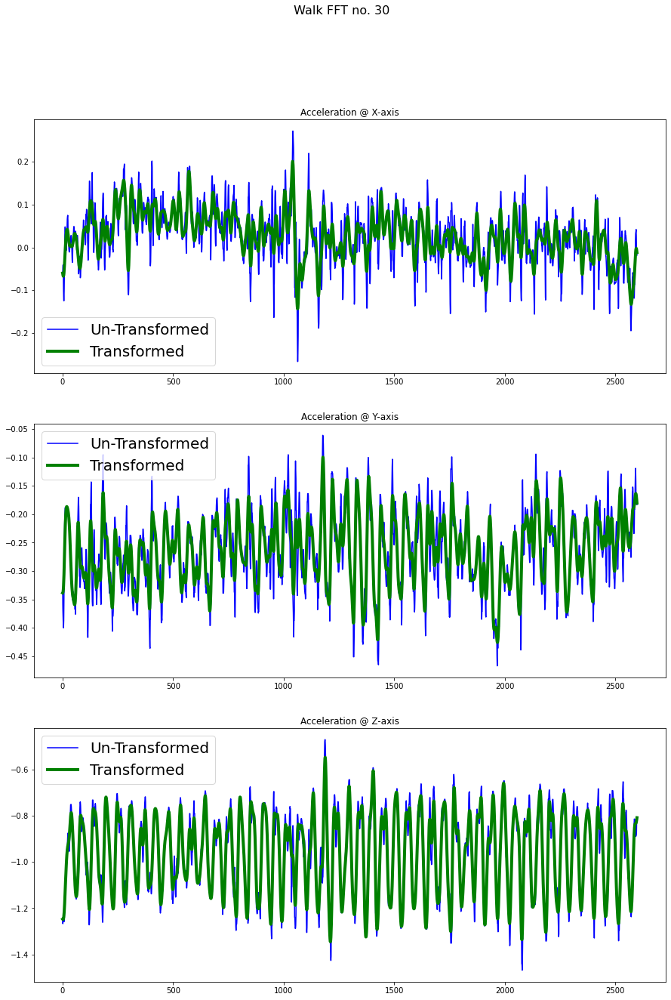

In [36]:
for i in range (30):
    fig, axes = plt.subplots(3,figsize=(15,21))
    
    fig.suptitle(' Walk FFT no. {}'.format(i+1), fontsize=16)
    
    axes[0].plot(walk_np[i]["gFx"],'blue',label='Un-Transformed')
    axes[0].plot(butter_worth_walk[i]["AccX"],'green', label='Transformed', linewidth=4.0)
    axes[0].legend(fontsize=20)
    axes[0].title.set_text('Acceleration @ X-axis')
    
    axes[1].plot(walk_np[i]["gFy"],'blue',label='Un-Transformed')
    axes[1].plot(butter_worth_walk[i]["AccY"],'green', label='Transformed', linewidth=4.0)
    axes[1].legend(fontsize=20)
    axes[1].title.set_text('Acceleration @ Y-axis')
    
    axes[2].plot(walk_np[i]["gFz"],'blue',label='Un-Transformed')
    axes[2].plot(butter_worth_walk[i]["AccZ"],'green', label='Transformed', linewidth=4.0)
    axes[2].legend(fontsize=20)
    axes[2].title.set_text('Acceleration @ Z-axis')
    
  
    
 

# 1(c) Saving the cleaned Walking data

In [37]:

for i in range(30):
    butter_worth_walk[i].to_csv("data/cleaned/walking/walk{}.csv".format(i+1), sep = ';',index=False)

#  2(a) ButterWorth Filter on Standing Data

In [38]:
butter_worth_standing = []
for i in range(30):
    butter_worth_standingX = signal.filtfilt(b, a, standing_np[i]["gFx"])
    butter_worth_standingY = signal.filtfilt(b, a, standing_np[i]["gFy"])
    butter_worth_standingZ = signal.filtfilt(b, a, standing_np[i]["gFz"])
    #butter_worth_walk_L =signal.filtfilt(b, a,walk_np[i]["acc"])
    
    
    butter_worth_standing.append((pd.DataFrame(list(zip(standing_np[i]['time'],butter_worth_standingX, butter_worth_standingY, butter_worth_standingZ,standing_np[i]['acc'])),
                                            columns=["Time","AccX", "AccY", "AccZ","Acc-old"])))
    
    
    
    

In [39]:
for i in range(30):
    butter_worth_standing[i]["Acc-trns"] = np.sqrt(butter_worth_standing[i]["AccX"]**2 * 
                                                     butter_worth_standing[i]["AccY"]**2 *
                                                     butter_worth_standing[i]["AccZ"]**2 ) 
    
butter_worth_standing[0]

,Time,AccX,AccY,AccZ,Acc-old,Acc-trns
0,56:10.0,0.024733,-0.418209,-0.853952,0.951,0.008833
1,56:10.0,0.023744,-0.419375,-0.871900,0.956,0.008682
2,56:10.0,0.022700,-0.420530,-0.889025,1.011,0.008487
3,56:10.1,0.021531,-0.421664,-0.904523,1.043,0.008212
4,56:10.1,0.020190,-0.422769,-0.917745,1.051,0.007834
...,...,...,...,...,...,...
1735,56:27.3,0.000684,-0.402660,-0.915092,1.006,0.000252
1736,56:27.3,0.002159,-0.401412,-0.917986,1.006,0.000796
1737,56:27.3,0.003666,-0.400154,-0.920879,1.008,0.001351
1738,56:27.3,0.005179,-0.398919,-0.923682,1.010,0.001908



# 2(b) Transformations on Standing data

/Users/Srimalaya/.conda/envs/CMPT353/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


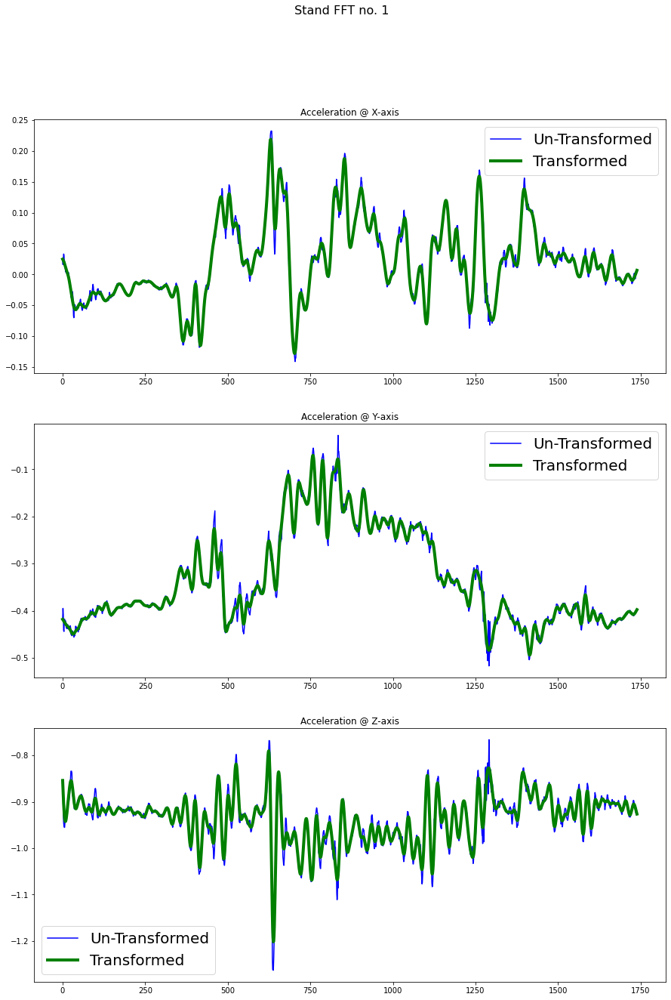

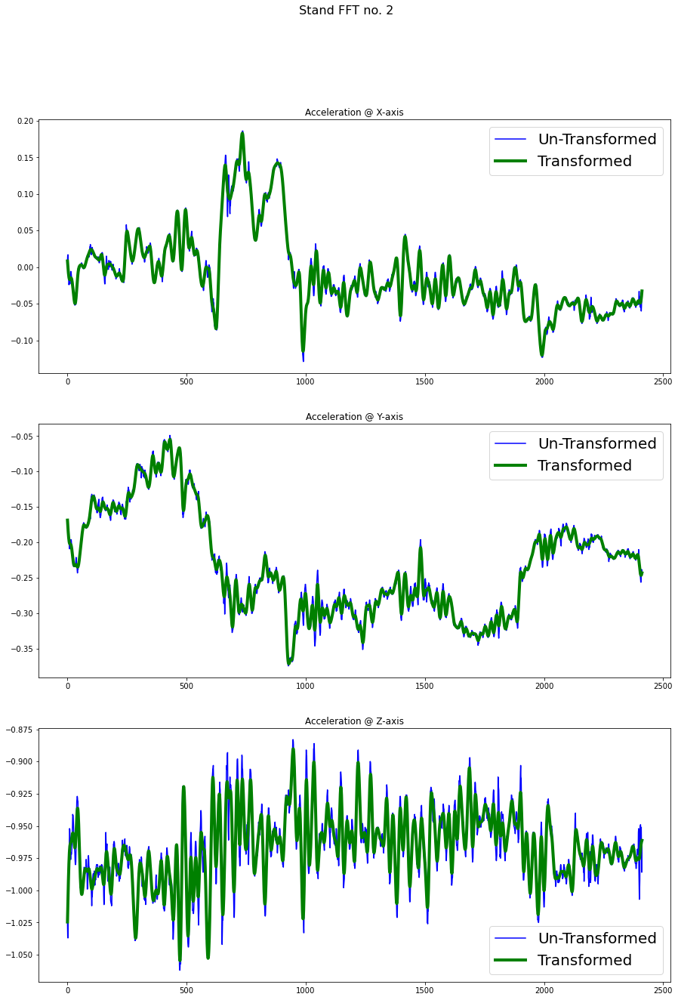

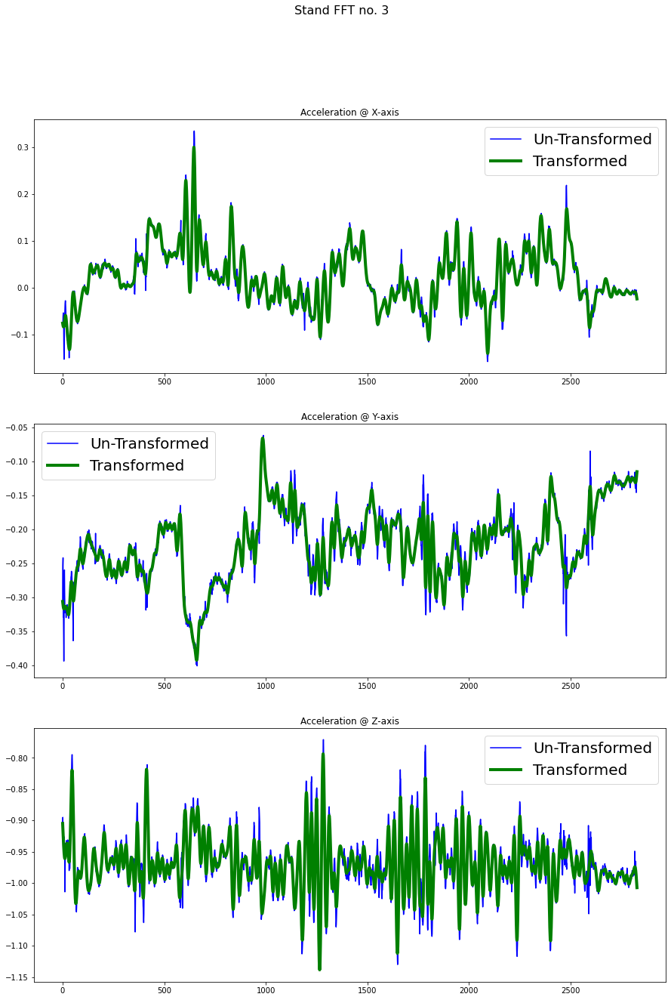

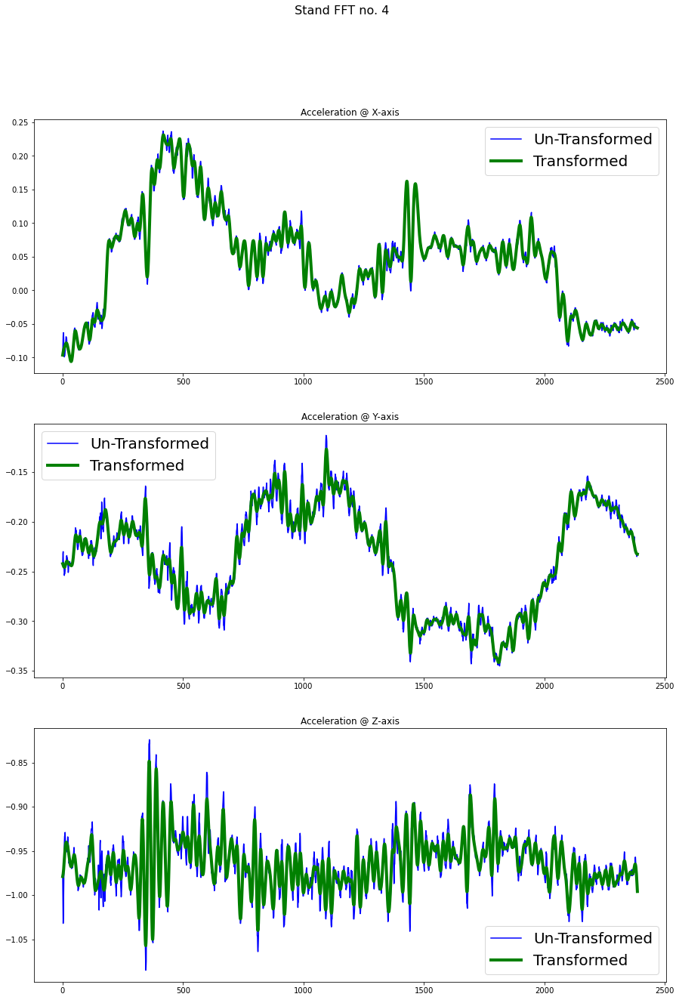

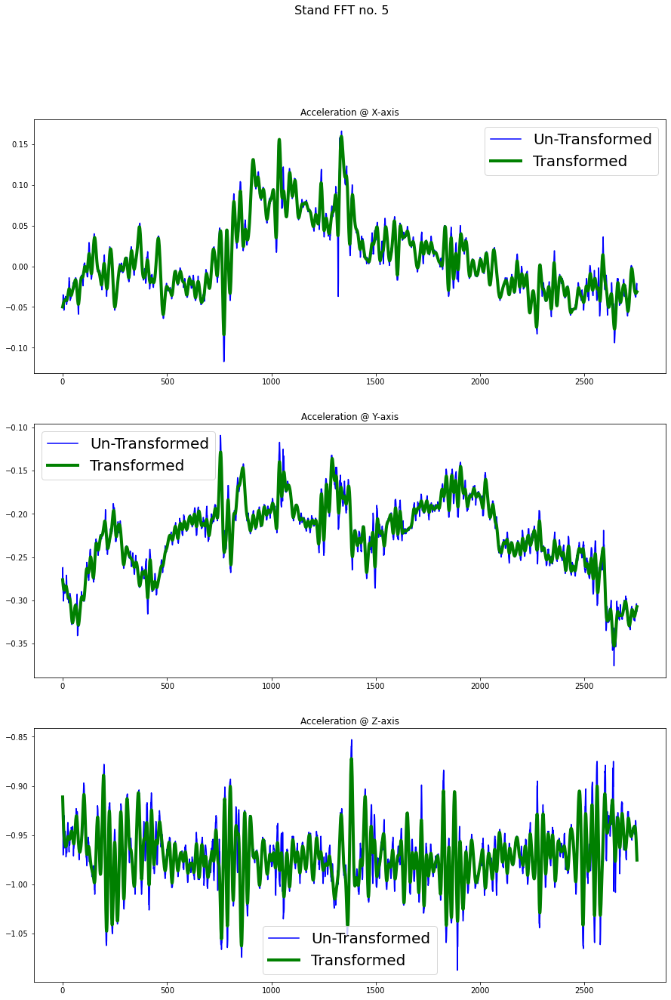

...

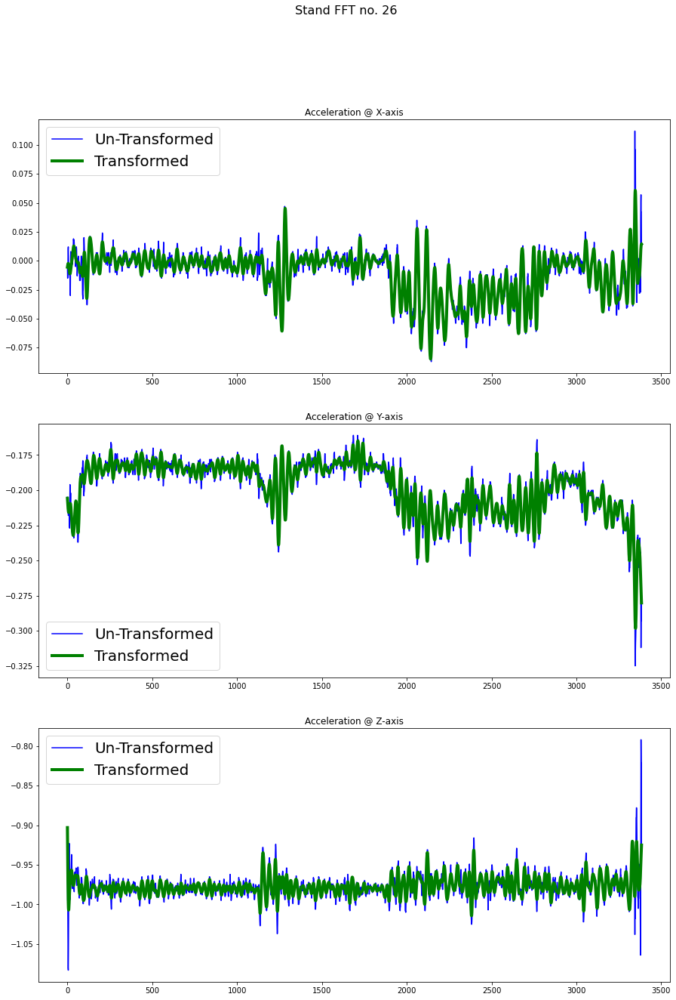

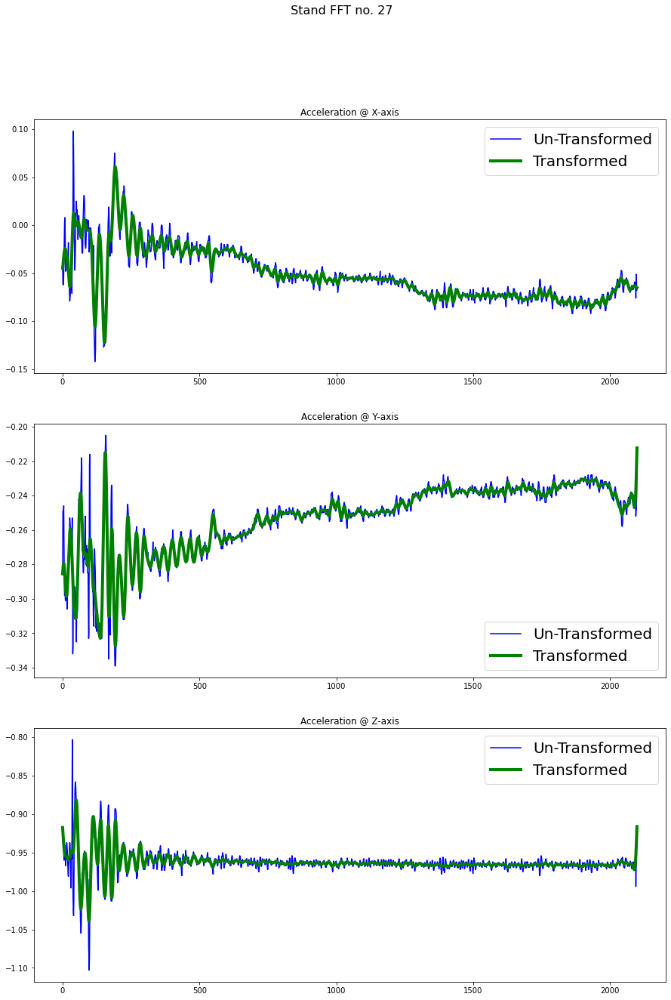

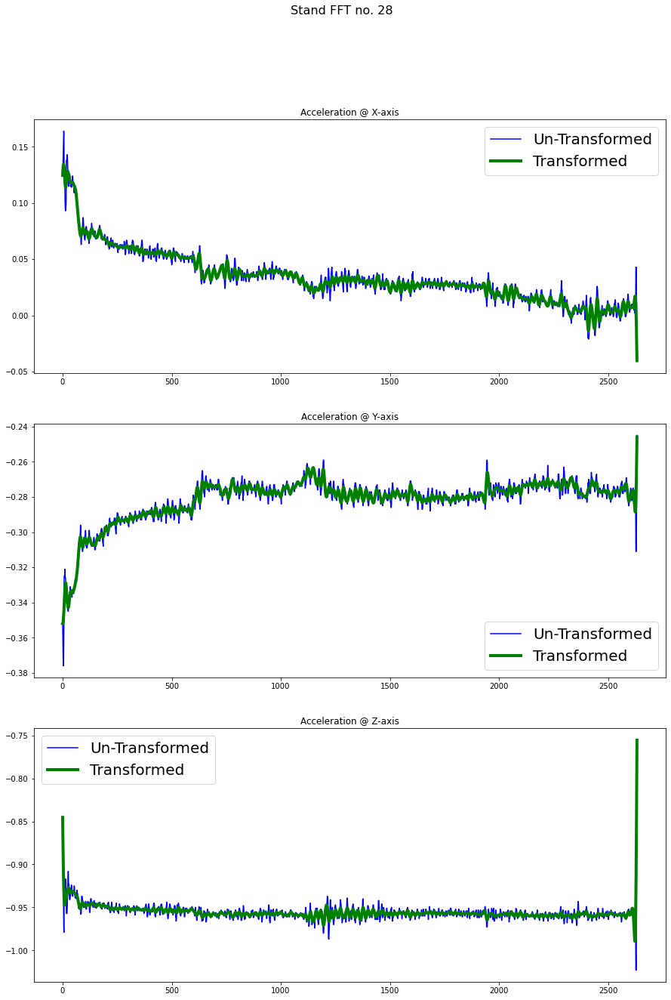

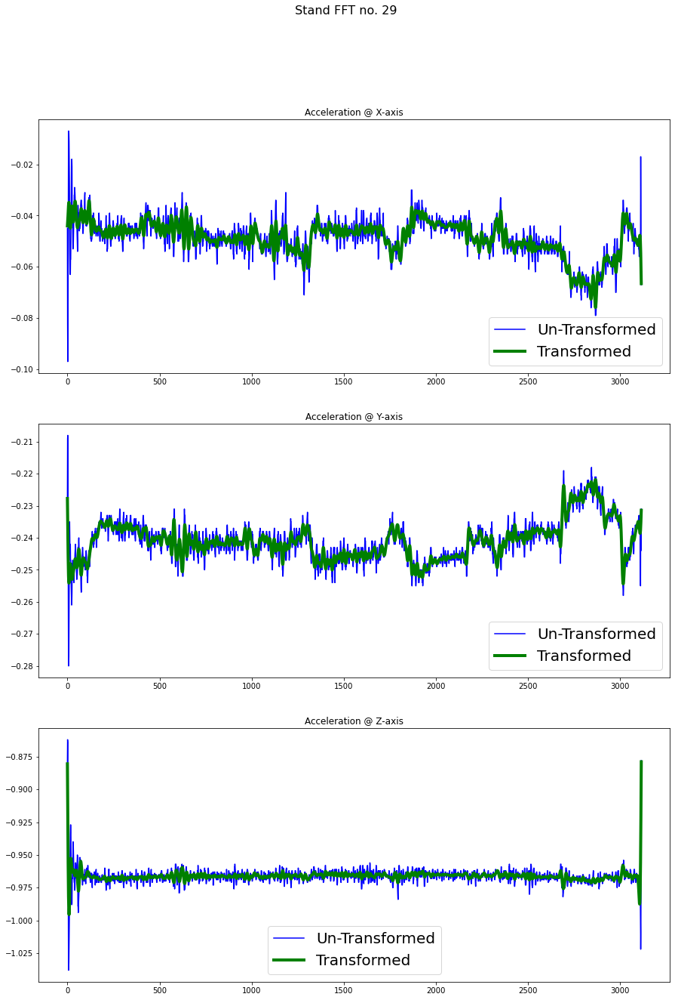

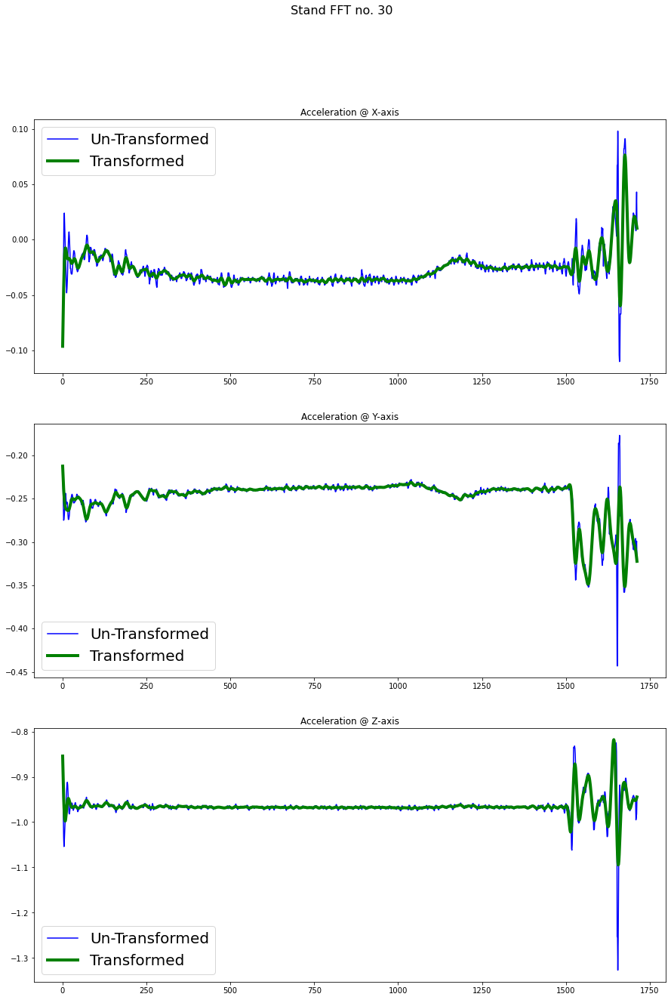

In [40]:
for i in range (30):
    fig, axes = plt.subplots(3,figsize=(15,21))
    
    fig.suptitle(' Stand FFT no. {}'.format(i+1), fontsize=16)
    
    axes[0].plot(standing_np[i]["gFx"],'blue',label='Un-Transformed')
    axes[0].plot(butter_worth_standing[i]["AccX"],'green', label='Transformed', linewidth=4.0)
    axes[0].legend(fontsize=20)
    axes[0].title.set_text('Acceleration @ X-axis')
    
    axes[1].plot(standing_np[i]["gFy"],'blue',label='Un-Transformed')
    axes[1].plot(butter_worth_standing[i]["AccY"],'green', label='Transformed', linewidth=4.0)
    axes[1].legend(fontsize=20)
    axes[1].title.set_text('Acceleration @ Y-axis')
    
    axes[2].plot(standing_np[i]["gFz"],'blue',label='Un-Transformed')
    axes[2].plot(butter_worth_standing[i]["AccZ"],'green', label='Transformed', linewidth=4.0)
    axes[2].legend(fontsize=20)
    axes[2].title.set_text('Acceleration @ Z-axis')
    


# 2(c) Saving the cleaned Standing Data

In [41]:
########Save the standing Cleaned/Transformed data here ######
for i in range(30):
    butter_worth_standing[i].to_csv("data/cleaned/standing/standing{}.csv".format(i+1), sep = ';',index=False)

# 3(a) ButterWorth Filter on Running data

In [42]:
butter_worth_running = []
for i in range(30):
    butter_worth_runningX = signal.filtfilt(b, a, running_np[i]["gFx"])
    butter_worth_runningY = signal.filtfilt(b, a, running_np[i]["gFy"])
    butter_worth_runningZ = signal.filtfilt(b, a, running_np[i]["gFz"])
    #butter_worth_walk_L =signal.filtfilt(b, a,walk_np[i]["acc"])
    
    
    butter_worth_running.append((pd.DataFrame(list(zip(running_np[i]['time'],butter_worth_runningX, butter_worth_runningY, butter_worth_runningZ,running_np[i]['acc'])),
                                            columns=["Time","AccX", "AccY", "AccZ","Acc-old"])))
    


In [43]:
for i in range(30):
    butter_worth_running[i]["Acc-trns"] = np.sqrt(butter_worth_running[i]["AccX"]**2 * 
                                                     butter_worth_running[i]["AccY"]**2 *
                                                     butter_worth_running[i]["AccZ"]**2 ) 
    


# 3(b) Transformations on Running data

/Users/Srimalaya/.conda/envs/CMPT353/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


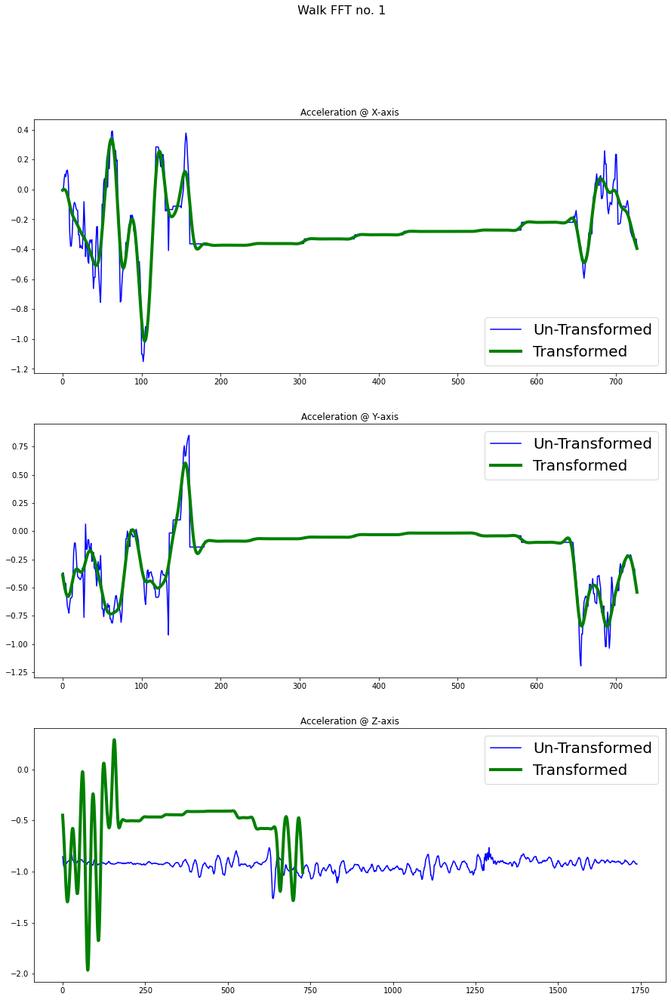

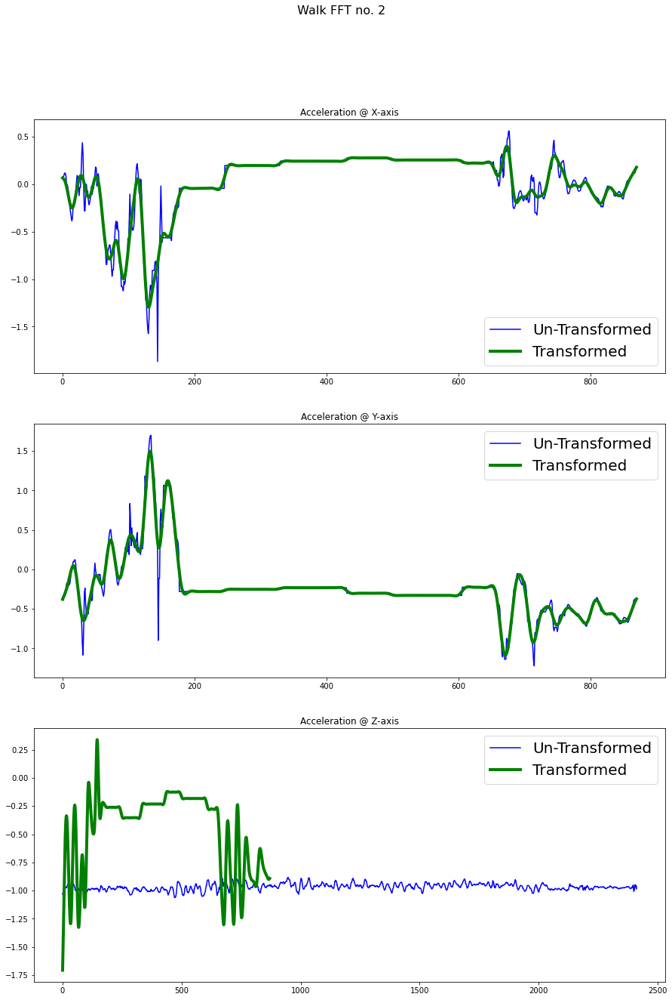

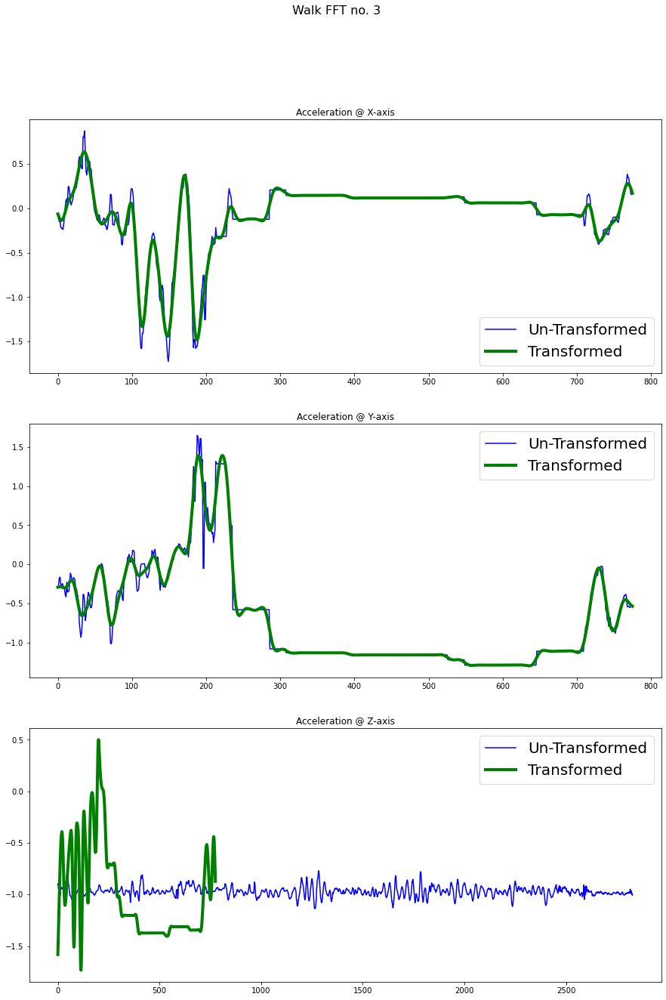

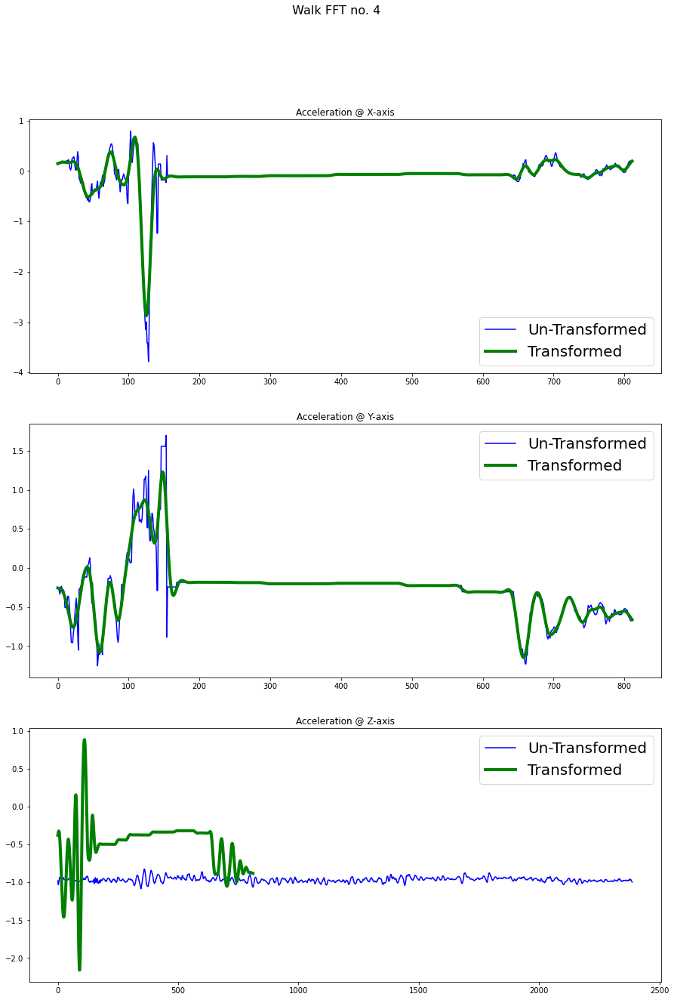

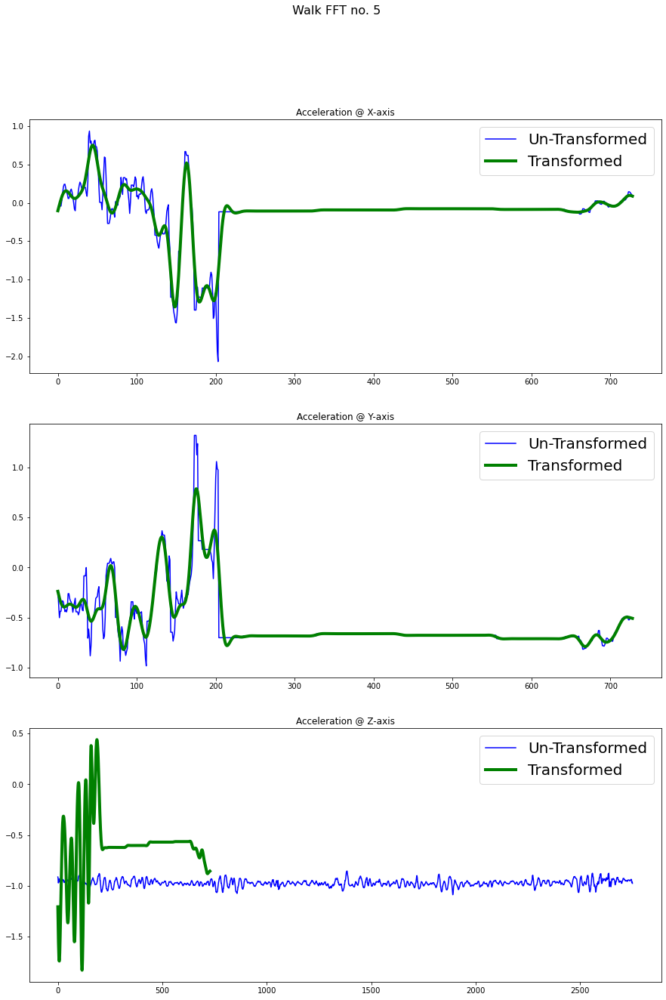

...

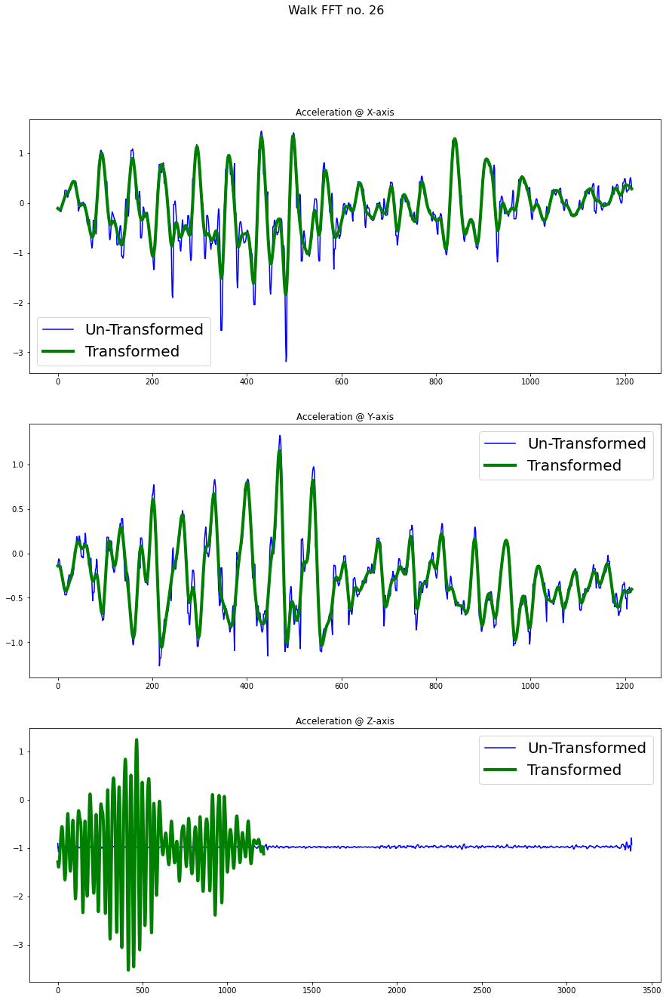

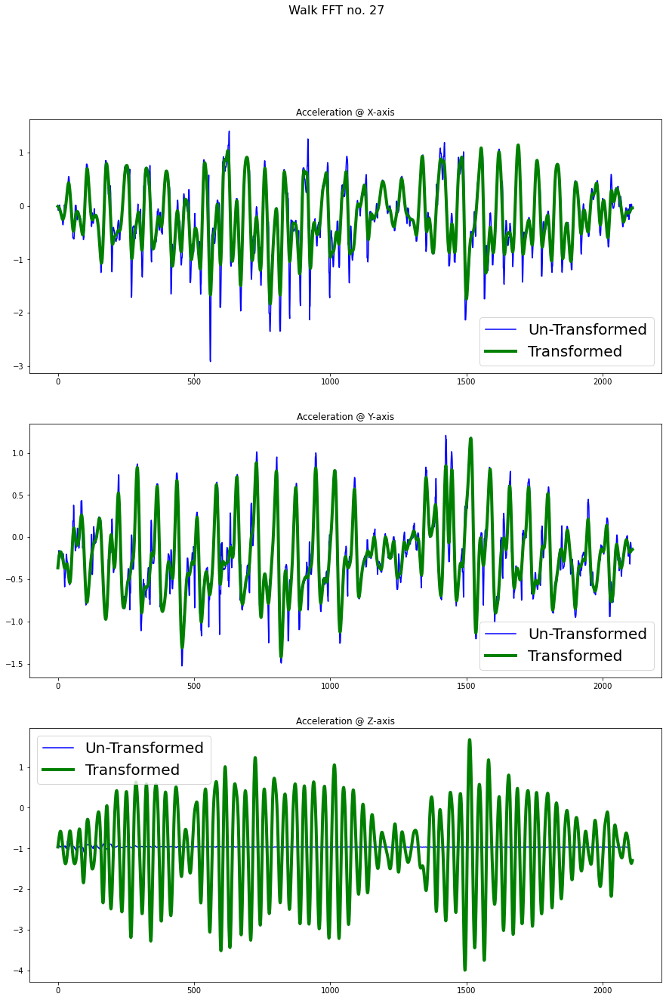

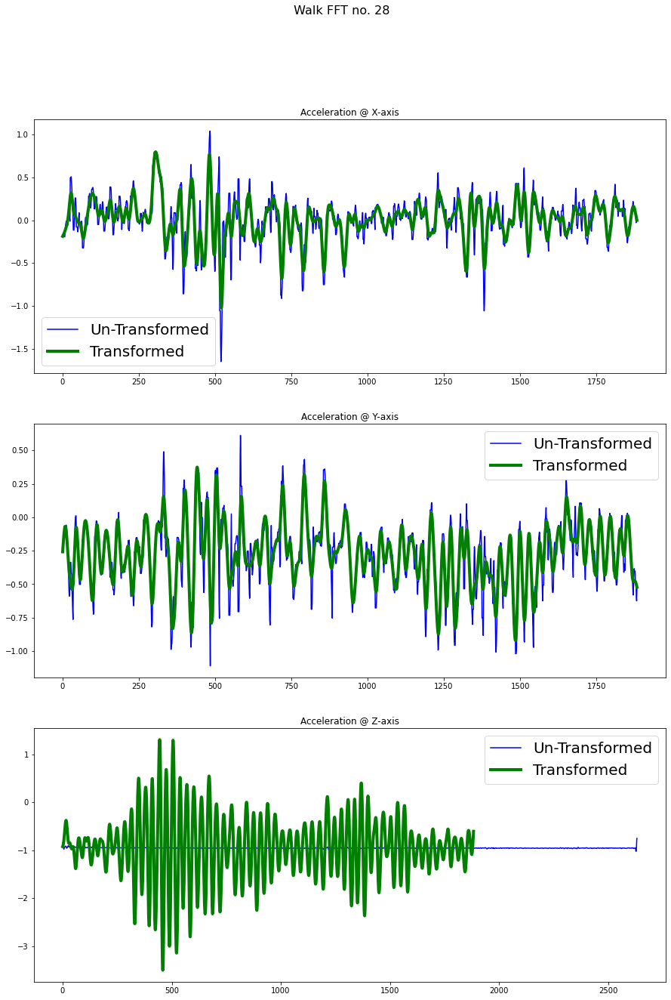

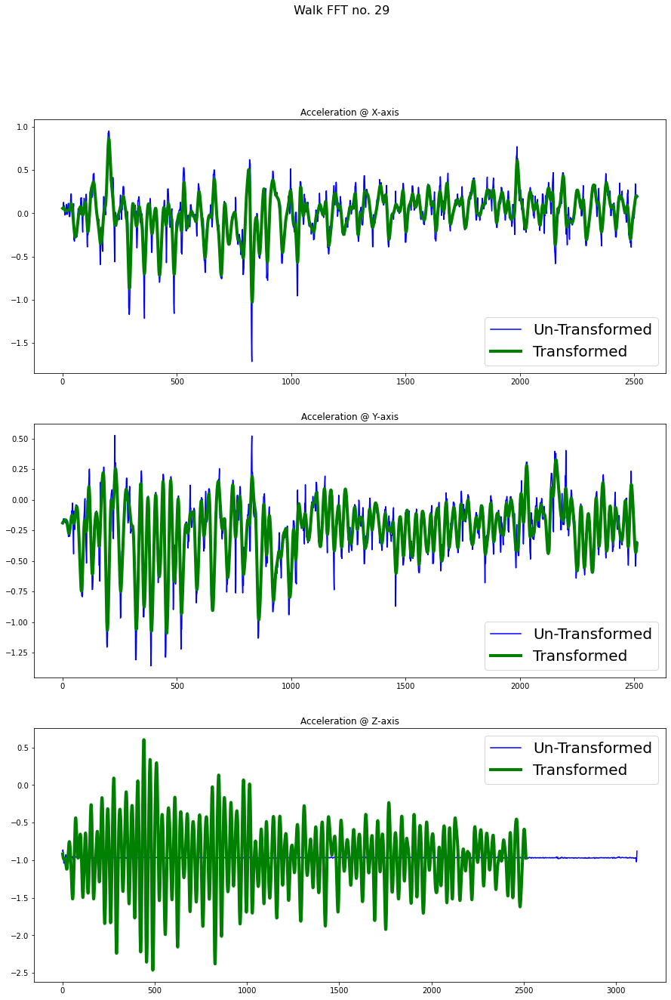

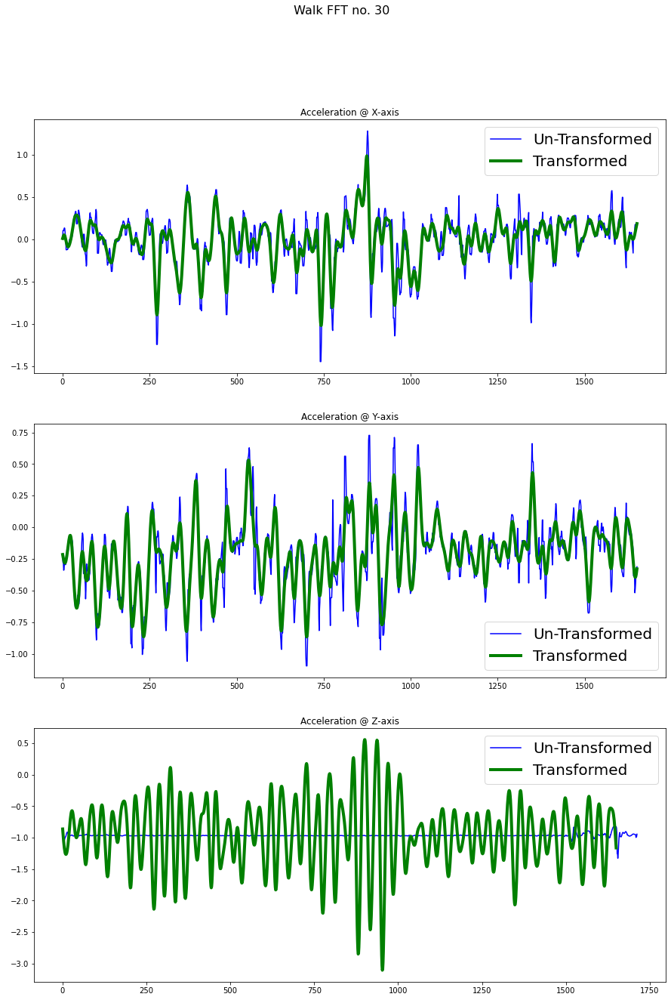

In [44]:
for i in range (30):
    fig, axes = plt.subplots(3,figsize=(15,21))
    
    fig.suptitle(' Walk FFT no. {}'.format(i+1), fontsize=16)
    
    axes[0].plot(running_np[i]["gFx"],'blue',label='Un-Transformed')
    axes[0].plot(butter_worth_running[i]["AccX"],'green', label='Transformed', linewidth=4.0)
    axes[0].legend(fontsize=20)
    axes[0].title.set_text('Acceleration @ X-axis')
    
    axes[1].plot(running_np[i]["gFy"],'blue',label='Un-Transformed')
    axes[1].plot(butter_worth_running[i]["AccY"],'green', label='Transformed', linewidth=4.0)
    axes[1].legend(fontsize=20)
    axes[1].title.set_text('Acceleration @ Y-axis')
    
    axes[2].plot(standing_np[i]["gFz"],'blue',label='Un-Transformed')
    axes[2].plot(butter_worth_running[i]["AccZ"],'green', label='Transformed', linewidth=4.0)
    axes[2].legend(fontsize=20)
    axes[2].title.set_text('Acceleration @ Z-axis')
    

# 3(c) Saving the cleaned Running Data

In [45]:
########Save the running Cleaned/Transformed data here ######
for i in range(30):
    butter_worth_running[i].to_csv("data/cleaned/running/running{}.csv".format(i+1), sep = ';',index=False)